# Proyecto Final 

El proyecto consiste en hacer clasificación binaria para determinar si una persona sobrevive ($y = 1$) o no ($y = 0$) al hundimiento del Titanic. Específicamente se desea crear un modelo con un nivel de exactitud de al menos el 80% (aunque es posible conseguir modelos de mayor exactitud). 

## Partes del Proyecto

El proyecto está dividido en 2 partes:

- **Entrenamiento, selección y validación**: Entrenamiento del modelo, feature engineering, validación y selección de hiperparámetros y modelos. Investigar sobre "K-fold cross validation", incluyendo una descripción de como se pudo haber utilizado en el proyecto. Si se aplica, se tomará como puntos extra.
- **Inferencia, predicción y despliegue**: Una vez entrenados los modelos, estos son usados para predicción sobre nuevas observaciones, comúnmente integrándolos a una aplicación de software. En este proyecto simularemos este proceso utilizando un segundo notebook donde se cargarán los modelos y se generarán predicciones sobre nuevos datos con los mismos.

--- 

## Especificaciones

### Ensemble Learning

El proyecto utilizará "ensemble learning" con 4 modelos diferentes: 

- **Árbol de decisión**: Scikit learn (función "fit")
- **SVM**: Scikit learn (función "fit")
- **Naive bayes**: Numpy o pandas
- **Regresión logística binaria**: Tensorflow (utilizar Tensorboard). Se recomienda utilizar regularización L1, L2 y variaciones en el factor de regularización. Utilizar mini batch gradient descent y una función sigmoide.

Se debe utilizar muestreo bootstrap (una porción del dataset completo para cada método). Se recomienda crear una función para el entrenamiento de cada tipo de modelo, el cual reciba los parámetros de entrenamiento y retorne el modelo entrenado (así como cualquier otra información necesaria y relevante). Por ejemplo:

   ```
   def train_SVM(X, Y, C, lr):
     …
     …
     return svm_model
   ```

### Bitácora

Para cada prueba o experimento realizado para los hiperparámetros del modelo se debe tomar nota de los mismos utilizando un CSV o un string que resuma la configuración del experimento. Luego, se debe guardar el modelo como tal, identificándolo con su string de configuración correspondiente. 

- **Sklearn**: Se puede utilizar la siguiente función para guardar el modelo

  ```
  from sklearn.externals import joblib
  joblib.dump(model, 'svm_lr=0.01_reg=0.1_var1_var2_var3.pkl')
  ```

- **Tensorflow**: Se puede ejecutar en la "session" los parámetros entrenables (luego del entrenamiento) y estos pueden ser asignados a un tensor de numpy.

  ```
  W = session.run(parametros, feed_dict)
  ```

  Luego podemos guardar el tensor de parámetros del modelo con la función "dump()". 
  
  ```
  W.dump("regLog_lr=0.01_reg=0.1_var1_var2_var3.npy")
  ```
  
  Tensorflow tiene métodos para exportar y desplegar modelos, los cuales se utilizan para modelos más complejos (modelos profundos). Se debe de investigar y anotar conclusiones sobre este tema. Si se aplican las funciones (export y deploy) se tomará como puntos extra.

Para cada modelo también se deben de guardar las métricas de evaluación: Accuracy, error, precisión o F1-Score, evaluados tanto en el dataset de entrenamiento como en el de validación. 

### Prueba / Evaluación Final

Predecir sobre el dataset de pruebas utilizando el mejor modelo para cada tipo de modelo. Combinar los resultados de todos los modelos utilizando la moda. Crear un dataframe de pandas con los resultados. Calcular métricas de evaluación comparando los $y$ reales contra los $y$ predichos. Si en la evaluación final no se obtiene la exactitud mínima deseada (80%), volver a la fase de experimentación.

Si se obtuvo la exactitud deseada, entonces agregar una sección de conclusiones y recomendaciones, incluyendo opiniones, experiencias, dificultades y lecciones aprendidas. 

### Deployment

En un notebook adicional e independiente del usado, "simular" como el modelo puede ser usado para realizar predicciones en nuevos datos. Para esto cargar los modelos elegidos:

- Sklearn: 
  
  ```
  svm_model = joblib.load('svm_lr=0.01_reg=0.1_var1_var2_var3.pkl')
  ```

- Tensorflow: 
  
  ```
  reg_model = np.load("regLog_lr=0.01_reg=0.1_var1_var2_var3.npy")
  ```

- Pandas:
  
  ```
  pd.read_csv()
  ```

Crear una función que prediga para cierta observación (una única observación), la predicción conjunta (la votación mayoritaria de todos los modelos). Para el caso del método del árbol de decisión, mostrar como este llega a la conclusión dada utilizando sklearn (https://scikit-learn.org/stable/modules/tree.html). Para bayes y la regresión logística mostrar la predicción probabilística. 

Probar la función descrita previamente para 10 observaciones distintas (pueden ser inventadas o parte del dataset original), alimentando de 1 en una las observaciones. 

### Investigaciones y Puntos Extra

- Investigar la técnica de "k-fold cross validation". Describir como se pudo haber aplicado al proyecto. Puntos extra si se utiliza.
- Anotar conclusiones sobre "export" y "deploy" de tensorflow. Puntos extra si se aplica.

---

In [1]:
# Paquetes utilizados
import pandas as pd 
import numpy as np 
import tensorflow as tf 
import sklearn as skl 
import matplotlib.pyplot as plt
import seaborn as sns

# Habilitar la compatibilidad con tensorflow v1 si se tienen tensorflow v2
if tf.__version__.startswith("2."):
  import tensorflow.compat.v1 as tf
  tf.compat.v1.disable_v2_behavior()
  tf.compat.v1.disable_eager_execution()
  print("Enabled compatitility to tf1.x")

Instructions for updating:
non-resource variables are not supported in the long term
Enabled compatitility to tf1.x


## Feature Engineering

In [2]:
# Se guardan los datos del CSV en un dataframe de pandas
raw_dataset = pd.read_csv("data_titanic_proyecto.csv")

# Se imprime el número de muestras o samples del dataset
print("Número de filas: ", len(raw_dataset))

# Primeras filas del dataframe
raw_dataset.head()

Número de filas:  891


,PassengerId,Name,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,passenger_class,passenger_sex,passenger_survived
0,1,"Braund, Mr. Owen Harris",22.0,1,0,A/5 21171,7.2500,NaN,S,Lower,M,N
1,2,"Cumings, Mrs. John Bradley (Florence Briggs Th...",38.0,1,0,PC 17599,71.2833,C85,C,Upper,F,Y
2,3,"Heikkinen, Miss. Laina",26.0,0,0,STON/O2. 3101282,7.9250,NaN,S,Lower,F,Y
3,4,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",35.0,1,0,113803,53.1000,C123,S,Upper,F,Y
4,5,"Allen, Mr. William Henry",35.0,0,0,373450,8.0500,NaN,S,Lower,M,N


Dadas las columnas anteriores, aquí se presenta una descripción de cada una de las variables que necesitan explicación:

- **SibSp**: Número de hijos / parejas a bordo
- **Parch**: Número de padres / hijos a bordo
- **Ticket**: El número del ticket 
- **Fare**: Precio del ticket 
- **Cabin**: Cabina o cuarto en el que se hospedó
- **Embarked**: Puerto donde subió (C = Cherbourg, Q = Queenstown, S = Southampton)
- **passenger_class**: Clase socioeconómica
- **passenger_survived**: El pasajero sobrevivió?

Al observar estas variables, se hace evidente que se deberán eliminar algunas. La columna de nombres muy difícilmente podrá ser codificada como tal debido a que esta tendría que ser tratada como una variable categórica, lo que implica que existiría una categoría por cada nombre y eso no resultaría particularmente útil para el algoritmo. Lo que se optará por hacer es separar la columna de nombre en nombres, apellidos y honorífico. Esto probablemente permitirá capturar algunas relaciones interesantes como la priorización de ciertos apellidos y honoríficos durante el escape. 

In [3]:
# Se crea un "feature engineering" dataset
fe_dataset = raw_dataset.copy()

# Se separa la columna de "name" en "first_name" y "last_name"
# Se emplea la opción "expand" para crear dos columnas a partir de una
fe_dataset[["last_name", "first_name"]] = raw_dataset["Name"].str.split(", ", expand = True)

# Se extrae el honorífico del "first_name" utilizando el punto como un separador
fe_dataset[["honorific", "first_name"]] = fe_dataset["first_name"].str.split(".", expand = True)

# Elimina la columna de "name"
fe_dataset = fe_dataset.drop("Name", axis = 1)

# Se visualiza la nueva estructura del dataset
fe_dataset.head()

,PassengerId,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,passenger_class,passenger_sex,passenger_survived,last_name,first_name,honorific
0,1,22.0,1,0,A/5 21171,7.2500,NaN,S,Lower,M,N,Braund,Owen Harris,Mr
1,2,38.0,1,0,PC 17599,71.2833,C85,C,Upper,F,Y,Cumings,John Bradley (Florence Briggs Thayer),Mrs
2,3,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S,Lower,F,Y,Heikkinen,Laina,Miss
3,4,35.0,1,0,113803,53.1000,C123,S,Upper,F,Y,Futrelle,Jacques Heath (Lily May Peel),Mrs
4,5,35.0,0,0,373450,8.0500,NaN,S,Lower,M,N,Allen,William Henry,Mr


El primer nombre de los pasajeros probablemente no aportará mucha información al modelo. La información que podría llegar a resultar más útil es la de si la persona estaba casada o soltera. A todas las mujeres casadas del dataset (todas las Mrs.) se les anotó bajo el nombre de su marido, por lo que se puede extraer el nombre de la mujer (entre paréntesis) y anotarla como "casada". Luego se puede hacer match con el nombre y apellido de su esposo y ponerlo a el también como "casado".

In [4]:
# Se obtiene el número de fila de todas las "mrs"
mrs = fe_dataset["honorific"] == "Mrs"

# Se extraen los nombres que contienen paréntesis
parenthesis = fe_dataset["first_name"].str.contains('(', regex = False)

# Este comando tiene dos partes
# Derecha: 
#   1. Se obtienen todos los "first_names" de aquellas "mrs" que contienen paréntesis. 
#   2. Se utiliza una expresión regular para separar el nombre de casada y soltera
#   3. La expresión genera 3 columnas nuevas "0" (copia de la siguiente), "maiden_name" y "single_name"
# Izquierda:
#   1. Se agregan las 3 nuevas columnas creadas por el regex al dataframe
#   2. Solo se agregan datos a las filas que son "mrs" con paréntesis en su nombre
fe_dataset.loc[mrs & parenthesis, ["temp", "married_name", "single_name"]] = fe_dataset.loc[mrs & parenthesis, "first_name"].str.extract('((?P<married_name>.+?) )?\((?P<single_name>.+)\)', expand = True)

# Se elimina la columna "temp" 
fe_dataset = fe_dataset.drop("temp", axis = 1)

# Se construye el nombre completo del esposo de cada Mrs
full_spouse_name = fe_dataset["married_name"].astype(str) + " " + fe_dataset["last_name"]

# Se eliminan las filas que contienen "nan"
# O mejor dicho, se mantienen solo las filas que no tienen "NaNs"
full_spouse_name = full_spouse_name[~full_spouse_name.str.contains("nan")]

# Se convierte el dataframe en una lista de strings
full_spouse_name = list(full_spouse_name)

# Se vuelven a construir los nombres completos 
full_name = fe_dataset["first_name"] + " " + fe_dataset["last_name"]

# Se elimina el texto adicional entre paréntesis de los nombres completos
full_name = full_name.str.replace(' \(.*\)', '', regex = True)

# Se elimina el texto adicional entre comillas
full_name = full_name.str.replace(' ".*"', '', regex = True)

# Se revisa si alguno de los nombres en "full_name" están en la
# lista de "full_spouse_name"
mr_married = full_name.isin(full_spouse_name)

# Se crea una nueva columna denominada "married"
# Inicialmente se asume que nadie está casado
fe_dataset["married"] = 0

# Se coloca como "casada" la persona que es una "mrs" (el honorífico indica esto)
# o que se comprobó que estaba casada con una "mrs"
fe_dataset.loc[mr_married | mrs, "married"] = 1

# Se eliminan las columnas sobrantes luego del proceso de determinar a los casados
# "first_name", "married_name" y "single_name".
fe_dataset = fe_dataset.drop(["first_name", "married_name", "single_name"], axis = 1)

Ahora se analiza el número de valores nulos en cada columna luego de eliminar la columna de ID

In [5]:
# Se elimina la columna de ID
fe_dataset = fe_dataset.drop("PassengerId", axis = 1)

# Se genera un resumen de los datos nulos
fe_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Age                 714 non-null    float64
 1   SibSp               891 non-null    int64  
 2   Parch               891 non-null    int64  
 3   Ticket              891 non-null    object 
 4   Fare                891 non-null    float64
 5   Cabin               204 non-null    object 
 6   Embarked            889 non-null    object 
 7   passenger_class     891 non-null    object 
 8   passenger_sex       891 non-null    object 
 9   passenger_survived  891 non-null    object 
 10  last_name           891 non-null    object 
 11  honorific           891 non-null    object 
 12  married             891 non-null    int64  
dtypes: float64(2), int64(3), object(8)
memory usage: 90.6+ KB


Analizando la tabla generada, se puede observar que las únicas columnas con valores nulos son las columnas de "cabin", "age" y "Embarked". La de "cabin" se destaca en particular, ya que de los 891 datos totales, únicamente 204 son "no nulos". Esto implica que si el dataset se fuera a reducir para eliminar los valores no nulos, únicamente quedaría un 23% de los valores originales. También se podría optar por realizar imputación, pero esto distorsionaría severamente la distribución real. En este caso se optará simplemente por eliminar la columna para evitar problemas en el futuro.

In [6]:
# Se elimina la columna de Cabin
fe_dataset = fe_dataset.drop("Cabin", axis = 1)

Para "Embarked" se utilizará una imputación de valores faltantes utilizando la moda (debido a su carácter categórico). 

In [7]:
# Se obtiene la moda de "Embarked" y se extrae su valor 
# Luego se reemplazan todos los NaNs (isna()) por la moda anterior
fe_dataset.loc[fe_dataset["Embarked"].isna(), "Embarked"] = fe_dataset["Embarked"].mode().values[0]

Para la variable de "Age" igualmente se utilizará imputación, pero por razones de análisis, esto se dejó para después. Por ahora se analizarán las diferentes categorías que se presentan para cada una de las variables categóricas

In [8]:
print("Embarked:", fe_dataset["Embarked"].unique())
print("Passenger Class:", fe_dataset["passenger_class"].unique())
print("Passenger Sex:", fe_dataset["passenger_sex"].unique())
print("Passengers survived:", fe_dataset["passenger_survived"].unique())
print("Honorific:", fe_dataset["honorific"].unique())
print("Unique last names:", len(fe_dataset["last_name"].unique()))
print("Unique Tickets:", len(fe_dataset["Ticket"].unique()))

Embarked: ['S' 'C' 'Q']
Passenger Class: ['Lower' 'Upper' 'Middle']
Passenger Sex: ['M' 'F']
Passengers survived: ['N' 'Y']
Honorific: ['Mr' 'Mrs' 'Miss' 'Master' 'Don' 'Rev' 'Dr' 'Mme' 'Ms' 'Major' 'Lady'
 'Sir' 'Mlle' 'Col' 'Capt' 'the Countess' 'Jonkheer']
Unique last names: 667
Unique Tickets: 681


Para todas estas variables categóricas se utilizará encoding para hacerlas más fácilmente procesables para los modelos. De acuerdo con [Alakh Sethi](https://www.analyticsvidhya.com/blog/2020/03/one-hot-encoding-vs-label-encoding-using-scikit-learn/), se deben de utilizar diferentes tipos de encoding para diferentes tipos de data categórica. Para variables ordinales (con un órden aparente) es recomendado utilizar label encoding, ya que permite capturar la relación de prioridad de un valor sobre el otro. Para variables no ordinales, se recomienda utilizar one hot encoding, de esta manera se evita que por ejemplo se le de más valor a un hombre, que a una mujer. 

Por lo tanto, para las variables con pocas categorías y de carácter ordinal ("passenger_class" y "passenger_survived") se utilizará label encoding.

In [9]:
from sklearn import preprocessing

# Se crea el objeto para label encoding (LE) para cada columna
LE_class = preprocessing.LabelEncoder()
LE_survived = preprocessing.LabelEncoder()

# Se hace el label encoding para cada variable
fe_dataset["passenger_class_enc"] = LE_class.fit_transform(fe_dataset["passenger_class"])
fe_dataset["passenger_survived_enc"] = LE_survived.fit_transform(fe_dataset["passenger_survived"])

 Para las variables con pocas categorías y ningún orden aparente ("passenger_sex" y "Embarked") se utilizará one hot encoding. Para ambos casos se utilizará scikit-learn para realizar estas operaciones. 

In [10]:
# =======================
# PASSENGER_SEX
# =======================

# Se crea el objeto para one hot encoding (OHE) de cada columna
OHE_sex = preprocessing.OneHotEncoder()

# Antes de aplicar el encoding, la data debe ser redimensionada usando "array.reshape(-1,1)"
data_to_encode = fe_dataset["passenger_sex"].values.reshape(-1,1)

# Se codifica el array anterior y luego se convierte como tal a un array
# (ya que la salida se obtiene como una "sparse matrix")
data_matrix_enc = OHE_sex.fit_transform(data_to_encode).toarray()

# 1. Se convierte la matriz anterior en un dataframe con ints
# 2. Se agregan las columnas generadas al dataset
fe_dataset[["Female", "Male"]] = pd.DataFrame(data_matrix_enc, columns = ["Female", "Male"]).astype(int)

# Para análisis posteriores, se crea una columna con "one-hot-encoding k-1" para
# el sexo (básicamente lo mismo que la columna "Female").
fe_dataset["passenger_sex_enc"] = fe_dataset["passenger_sex"].astype('category')
fe_dataset["passenger_sex_enc"] = fe_dataset["passenger_sex_enc"].cat.codes

# =======================
# EMBARKED
# =======================

# Se crea el objeto para one hot encoding (OHE) de cada columna
OHE_embarked = preprocessing.OneHotEncoder()

# Antes de aplicar el encoding, la data debe ser redimensionada usando "array.reshape(-1,1)"
data_to_encode = fe_dataset["Embarked"].values.reshape(-1,1)

# Se codifica el array anterior y luego se convierte como tal a un array
# (ya que la salida se obtiene como una "sparse matrix")
data_matrix_enc = OHE_embarked.fit_transform(data_to_encode).toarray()

# 1. Se convierte la matriz anterior en un dataframe con ints
# 2. Se agregan las columnas generadas al dataset
fe_dataset[["C", "Q", "S"]] = pd.DataFrame(data_matrix_enc, columns = ["C", "Q", "S"]).astype(int)

# Para análisis posteriores, se crea una columna con label encoding para "Embarked"
fe_dataset["embarked_enc"] = fe_dataset["Embarked"].astype('category')
fe_dataset["embarked_enc"] = fe_dataset["embarked_enc"].cat.codes

Por otro lado, las variables de "last_name" y "honorific" cuentan con un número mucho mayor de categorías (en particular la variable "last_name" que cuenta con 667 categorías distintas). Debido a esto, para estas variables se utilizará una codificación de frecuencia (se coloca el porcentaje de ocurrencia para cada categoría, en lugar de la categoría como tal), esto permitirá que se siga expresando lo que se buscaba con la variable (se priorizan ciertos apellidos u honoríficos por su frecuencia) mientras se reduce el número de valores únicos.

In [11]:
# Columnas a las que se le aplicará frequency encoding
freq_enc_columns = ["last_name", "honorific"]

# Se itera sobre cada columna para frequency encoding
for column in freq_enc_columns:

    # Función que obtiene el porcentaje de ocurrencia de cada categoría
    frequency_encode = fe_dataset.groupby(column).size() / len(fe_dataset)

    # Se asigna a cada categoría su porcentaje de ocurrencia
    fe_dataset[column + "_enc"] = fe_dataset[column].apply(lambda x: frequency_encode[x])

También cabe mencionar que "Ticket" es otra variable "categórica", sin embargo, si se mide por si sola esta cuenta con un número muy alto de categorías. Curiosamente, se esperaría que existieran tantas categorías como hay filas en el dataset (cada pasajero tiene un número único de ticket), no obstante existen muchas menos categorías (681). Esto indica que posiblemente familiares, amigos y parejas compartieron su ticket. Esto significa que el precio o "fare" no refleja correctamente el precio del ticket. Para corregir esto se crean dos variables nuevas, el precio del ticket por persona y el tamaño del grupo que compartió el Ticket. Esta idea fue obtenida de la submission de Kaggle por [Stefan Schulmeister](https://www.kaggle.com/stefanschulmeister87/an-extensive-data-journey-on-the-titanic-top-5)

In [12]:
# Se inicializan las nuevas columnas 
fe_dataset["fare_per_person"] = 0.0             # Se inicializa con floats para obtener decimales 
fe_dataset["group_size"] = 0                    # Se inicializa con ints para obtener enteros

# Se recorre cada fila en el dataset
for ind, row in raw_dataset.iterrows():
    
    # 1. Se extrae el número de ocurrencias para cada tipo de ticket
    # 2. Se extrae el tipo de ticket actual y se indexa el resultado anterior
    # 3. El resultado es el tamaño de grupo 
    group_size = raw_dataset["Ticket"].value_counts()[row["Ticket"]]

    # Se agrega el precio por persona y tamaño de grupo a cada columna
    fe_dataset.at[ind, "fare_per_person"] = row["Fare"] / group_size
    fe_dataset.at[ind, "group_size"] = group_size

# Se elimina la columna de fare previa
fe_dataset = fe_dataset.drop("Fare", axis = 1)

Para reducir el número de categorías presente en "Ticket", se puede dividir cada valor de ticket en dos partes: Un prefijo (A/5, PC, STON/02, etc) y un número. Muchos de los tickets no cuentan con categorías, por lo que la categoría "NaN" se sustituye por una de "No Prefix". Dados estos cambios, la nueva variable de "ticket_prefix" tiene muchas menos categorías que la columna de "Ticket" original. La variable de "ticket_number" se convertirá en una variable numérica, aunque no se utilizará ya que parece no guardar ningún significado.

In [13]:
# Se divide la variable de Ticket en un prefijo y un número
fe_dataset[["temp", "ticket_prefix", "ticket_number"]] = fe_dataset["Ticket"].str.extract("((?P<prefix>.*) )?(?P<number>\d*)", expand = True)

# La operación anterior genera una columna adicional que consiste 
# de una copia de "ticket_prefix". Se elimina esta columna
fe_dataset = fe_dataset.drop("temp", axis = 1)

# También se elimina la columna de "Ticket"
fe_dataset = fe_dataset.drop("Ticket", axis = 1)

# Se sustituye la categoría "nan" (sin prefijo) por "No Prefix"
fe_dataset.loc[fe_dataset["ticket_prefix"].isna(), "ticket_prefix"] = "No Prefix"

# Se listan todas las categorías en "ticket_prefix"
print("Ticket prefixes:", fe_dataset["ticket_prefix"].unique())

# Se convierte en un número la columna de "ticket_number"
fe_dataset["ticket_number_int"] = pd.to_numeric(fe_dataset["ticket_number"])

# Al convertir a número "ticket_number" habían algunas casillas sin número
# que se convirtieron en NaNs. Se igualan los NaNs a 0.
fe_dataset.loc[fe_dataset["ticket_number_int"].isna(), "ticket_number_int"] = 0

# Se hace label encoding del "ticket_prefix"
fe_dataset["ticket_prefix_enc"] = fe_dataset[column].astype('category')
fe_dataset["ticket_prefix_enc"] = fe_dataset["ticket_prefix_enc"].cat.codes

Ticket prefixes: ['A/5' 'PC' 'STON/O2.' 'No Prefix' 'PP' 'A/5.' 'C.A.' 'A./5.' 'SC/Paris'
 'S.C./A.4.' 'A/4.' 'CA' 'S.P.' 'S.O.C.' 'SO/C' 'W./C.' 'SOTON/OQ'
 'W.E.P.' 'STON/O 2.' 'A4.' 'C' 'SOTON/O.Q.' 'SC/PARIS' 'S.O.P.' 'A.5.'
 'Fa' 'CA.' 'F.C.C.' 'W/C' 'SW/PP' 'SCO/W' 'P/PP' 'SC' 'SC/AH' 'A/S'
 'SC/AH Basle' 'A/4' 'WE/P' 'S.W./PP' 'S.O./P.P.' 'F.C.' 'SOTON/O2'
 'S.C./PARIS' 'C.A./SOTON']


Se visualiza el nuevo estado del dataset luego del feature engineering

In [14]:
fe_dataset.head()

,Age,SibSp,Parch,Embarked,passenger_class,passenger_sex,passenger_survived,last_name,honorific,married,...,S,embarked_enc,last_name_enc,honorific_enc,fare_per_person,group_size,ticket_prefix,ticket_number,ticket_number_int,ticket_prefix_enc
0,22.0,1,0,S,Lower,M,N,Braund,Mr,0,...,1,2,0.002245,0.580247,7.2500,1,A/5,21171,21171.0,11
1,38.0,1,0,C,Upper,F,Y,Cumings,Mrs,1,...,0,0,0.001122,0.140292,71.2833,1,PC,17599,17599.0,12
2,26.0,0,0,S,Lower,F,Y,Heikkinen,Miss,0,...,1,2,0.001122,0.204265,7.9250,1,STON/O2.,3101282,3101282.0,8
3,35.0,1,0,S,Upper,F,Y,Futrelle,Mrs,1,...,1,2,0.002245,0.140292,26.5500,2,No Prefix,113803,113803.0,12
4,35.0,0,0,S,Lower,M,N,Allen,Mr,0,...,1,2,0.002245,0.580247,8.0500,1,No Prefix,373450,373450.0,11


## Análisis de Datos

Se inicia seleccionando los datos que se analizarán y obteniendo diferentes métricas estadísticas de las variables de interés

In [15]:
# Dataset completo de las variables independientes y la de predicción o la dependiente
analysis_dataset = fe_dataset[["Age", "SibSp", "Parch", "fare_per_person", "embarked_enc", "passenger_class_enc", "passenger_sex_enc", 
                               "last_name_enc", "honorific_enc", "married", "ticket_prefix_enc", "ticket_number_int", "group_size",
                               "passenger_survived_enc"]]

# Resumen estadístico de todas las variables
analysis_dataset.describe()

,Age,SibSp,Parch,fare_per_person,embarked_enc,passenger_class_enc,passenger_sex_enc,last_name_enc,honorific_enc,married,ticket_prefix_enc,ticket_number_int,group_size,passenger_survived_enc
count,714.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,8.910000e+02,891.000000,891.000000
mean,29.699118,0.523008,0.381594,17.788989,1.536476,0.691358,0.647587,0.002112,0.400240,0.187430,10.241302,2.969891e+05,1.787879,0.383838
std,14.526497,1.102743,0.806057,21.218157,0.791503,0.836071,0.477990,0.001670,0.215863,0.390475,1.830798,6.564383e+05,1.361142,0.486592
min,0.420000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001122,0.001122,0.000000,0.000000,0.000000e+00,1.000000,0.000000
25%,20.125000,0.000000,0.000000,7.762500,1.000000,0.000000,0.000000,0.001122,0.204265,0.000000,8.000000,1.431250e+04,1.000000,0.000000
50%,28.000000,0.000000,0.000000,8.850000,2.000000,0.000000,1.000000,0.001122,0.580247,0.000000,11.000000,1.120580e+05,1.000000,0.000000
75%,38.000000,1.000000,0.000000,24.288200,2.000000,1.000000,1.000000,0.002245,0.580247,0.000000,11.000000,3.470820e+05,2.000000,1.000000
max,80.000000,8.000000,6.000000,221.779200,2.000000,2.000000,1.000000,0.010101,0.580247,1.000000,16.000000,3.101317e+06,7.000000,1.000000


De acuerdo con estos resultados:
- La probabilidad de supervivencia promedio era del 38%
- La edad promedio de los pasajeros (ignorando valores nulos) era de aproximadamente 30 años
- La persona más "adulta" a bordo contaba con 80 años.
- El 65% de las personas a bordo eran hombres.
- El precio por persona promedio para los tickets rondaba alrededor de los 18 dólares.
- En promedio, la mayor parte de grupos dentro del titanic eran parejas.
- En promedio, únicamente el 19% de las personas a bordo estaban casadas (sujeto a posible sesgo)

Ahora se analiza la correlación entre variables de forma visual generando diferentes gráficos: Uno de densidad para cada variable y otro de dispersión para cada combinación posible entre las variables. Al conjunto de todas estas gráficas se le denomina "Pairplot" dentro del paquete de seaborn.

Text(0.5, 0.98, 'Pairplot - Dataset Titanic')

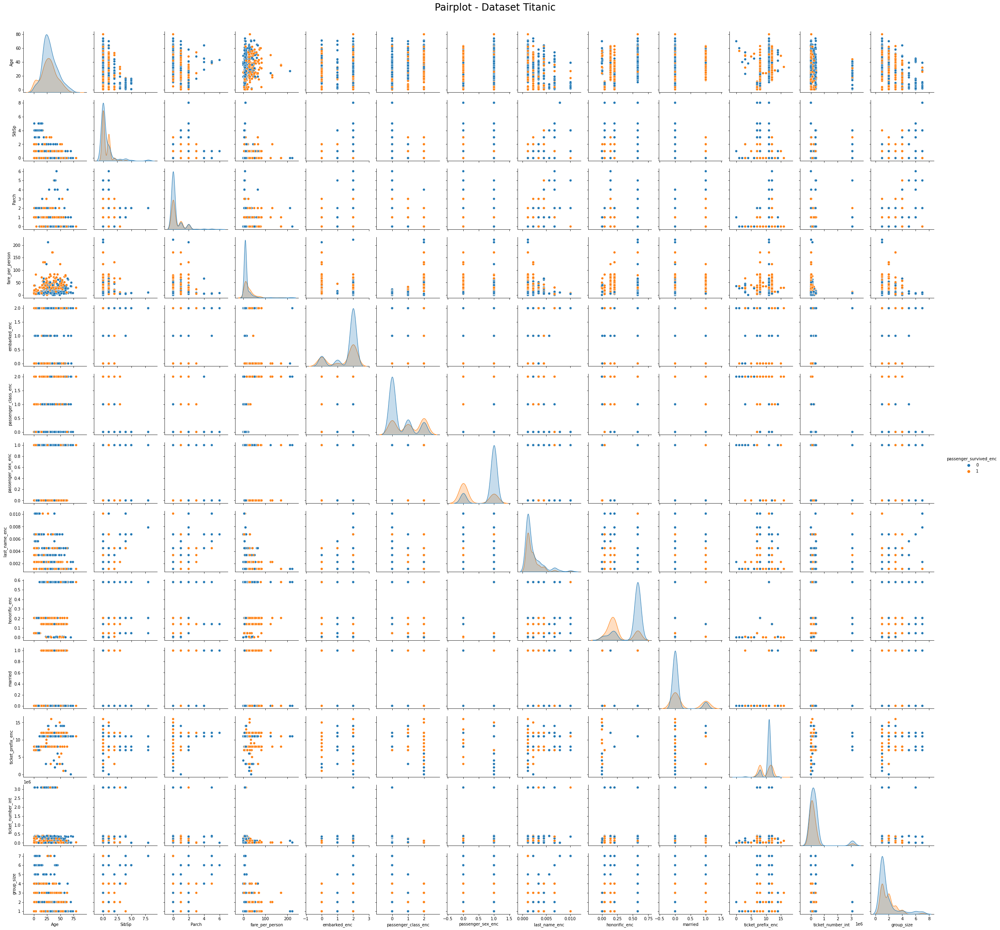

In [16]:
g = sns.pairplot(analysis_dataset, hue = "passenger_survived_enc")
g.fig.subplots_adjust(top = 0.95)
g.fig.suptitle("Pairplot - Dataset Titanic", fontsize = "24")

Al analizar este gráfico se hacen evidentes algunas relaciones. En primer lugar, se puede observar que la forma de los gráficos de densidad de cada variable, tanto para el caso de la gente que sobrevivió, como para la que murió, es muy similar en términos de su forma. La única diferencia es que el gráfico de densidad para la gente que sobrevivió parece consistir de una versión escalada del gráfico para la gente que murió. Además de esto, parecen existir algunas reslaciones interesantes, como el hecho que la gente soltera con cualquier tipo de ticket fue más propicia a morir, que aquella casada. También parece existir una fuerte relación entre el número de muertos, la clase socioeconómica a la que pertencían y la edad que tenían: La gente de clase baja pareció morir más sin importar su edad, mientras que la gente de clase alta únicamente murió si su edad era muy avanzada o se encontraba cercana a la mediana edad. 

Ahora se confirma cualquier sospecha de "correlación" entre variables generando un gráfico de correlación. 

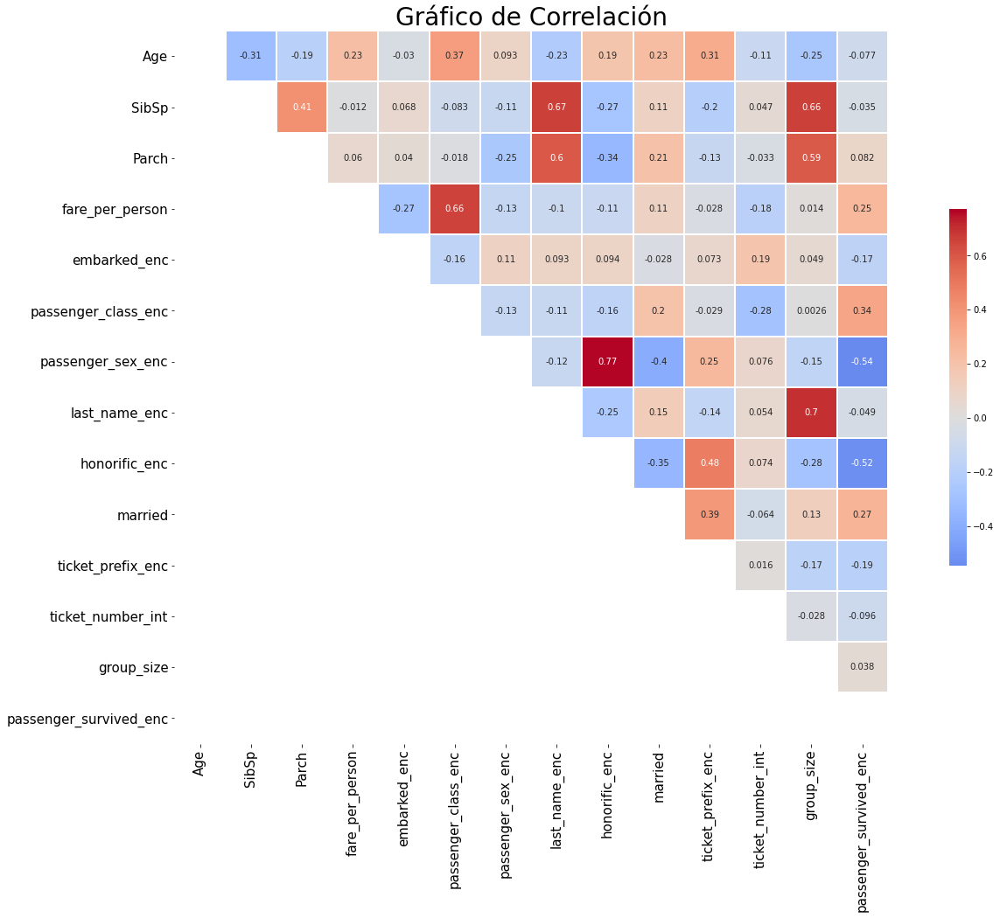

In [17]:
# Se obtiene una matriz de correlación entre variables del dataset
corr = analysis_dataset.corr()

# Se crea una máscara para mostrar solo los valores superiores
# de la matriz de correlación
mask = np.tril(np.ones_like(corr, dtype = bool))

# Se crea la figura
fig, ax = plt.subplots(figsize = (25,15))

# Se cambia el tamaño de los labels 
ax.tick_params(axis = 'both', which = 'major', labelsize = 15)

# Plot the heatmap for correlation
g = sns.heatmap(corr, mask = mask, center = 0, square = True, cmap = "coolwarm", linewidths = 1, annot = True, cbar_kws = {"shrink": 0.5}).set_title("Gráfico de Correlación", fontsize = "28")


Al ver el gráfico de correlación se hacen claras algunas relaciones:

- "passenger_sex" y "honorific": Dado que los honoríficos son diferentes para cada sexo (Mr para hombres y Miss o Mrs para mujeres), esto era de esperarse. 

- "Sibsp" y "Parch" con "last_name_enc": Es evidente que los apellidos de los pasajeros van a estar íntimamente relacionados con el número de hijos, parejas y/o padres a bordo. 

- "Sibsp" y "Parch" con "group_size": La alta correlación de estas variables confirma el hecho de que las personas con las que se compartían los tickets eran familia.

- "Sibsp" y "married": Estas variables no parecen tener relación a pesar de que el número de "Sibsp" debería de subir mientras mayor sea el número de casados. Esta falta de correlación se podría atribuir al hecho que esta información se extrajo en base a la información encontrada en los nombres de las mujeres casadas o "Mrs". Dado que el dataset es mayoritariamente masculino, es de esperar que la información extraída esté incompleta o severamente sesgada. Si se llega a observar que "married" no genera una diferencia significativa en el entrenamiento se va a optar por desechar la misma (con el dolor de mi corazón, me costó mucho extraerla)

In [18]:
# Función: Cálculo y ploteo de porcentaje de supervivencia por categoría
def plotSurvivalPerColumn(column, survival_col_name, plot_title):

    # Se obtiene el número de elementos en cada categoría
    count = fe_dataset.groupby(column).count()

    # Se obtiene el número de supervivientes
    suma = fe_dataset.groupby(column).sum()

    # Se divide la suma dentro de la cuenta para obtener el porcentaje
    tasa = suma[survival_col_name] / count[survival_col_name]

    # Se copia la tabla de "count" en df
    # Se agregan los datos de la tasa de supervivencia a una nueva columna
    # Se agregan las labels de cada fila a una nueva columna
    df = count.copy()
    df["survived"] = tasa
    df[column] = tasa.index

    # Se grafica el gráfico de barras
    g = sns.catplot(y = column, x = "survived", data = df, kind = "bar", aspect = 2, height = 4)
    g.fig.subplots_adjust(top = 0.9)
    g.fig.suptitle(plot_title, fontsize = 20)
    g.set_xticklabels(fontsize = 12)
    g.set_yticklabels(fontsize = 12)
    plt.show()

- "passenger_survived" y "passenger_sex": Parece que las personas del Titanic si respetaron el lema de "mujeres y niños primero". Las mujeres sobrevivieron en mayores porcentajes, aunque debido al carácter mayoritariamente masculino de la tripulación, también podría tratarse de un caso de sesgo.

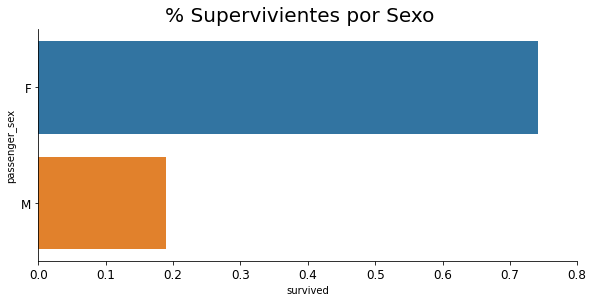

In [19]:
plotSurvivalPerColumn("passenger_sex", "passenger_survived_enc", "% Supervivientes por Sexo")

- "passenger_survived" y "honorific": Parece existir una correlación alta entre el honorífico del tripulante y su supervivencia. Al visualizar el honorífico se hace todavía más clara la relación entre el sexo y la supervivencia: Todos los honoríficos pertenecientes a mujeres cuentan con los porcentajes de supervivencia más altos. Ni si quiera títulos de realeza masculinos como "Jonkheer" y "Master" se comparan con los porcentajes de supervivencia de las mujeres abordo. Curiosamente, parece que las muejeres con un honorífico correspondiente a solteras o menores sobrevivieron más que las casadas. De nuevo se refuerza la noción que los tripulantes si cumplieron con el "mujeres y niños primero". 

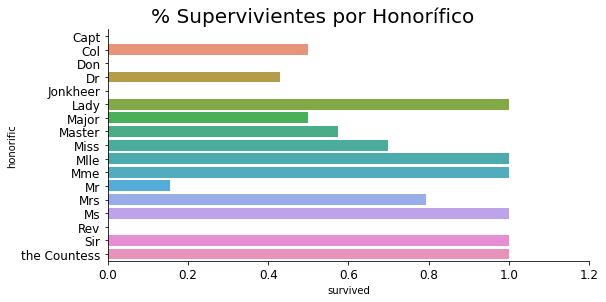

In [20]:
plotSurvivalPerColumn("honorific", "passenger_survived_enc", "% Supervivientes por Honorífico")

- "passenger_survived" y "passenger_class": También se pudo llegar a observar que existe una correlación positiva entre el número de supervivientes y la clase socioeconómica de los mismos. Esto se confirma al generar el gráfico de porcentaje de supervivencia, donde se observa que mientras mejor era la clase socioeconómica, mejor era el chance de supervivencia. 

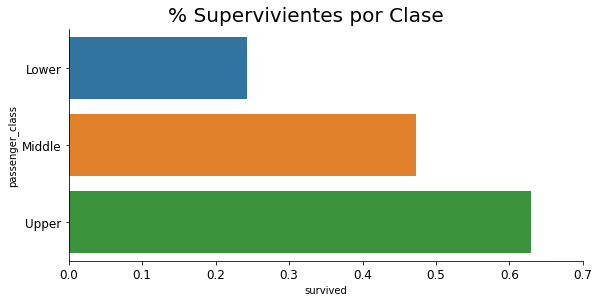

In [21]:
plotSurvivalPerColumn("passenger_class", "passenger_survived_enc", "% Supervivientes por Clase")

## Últimos Preparativos

Antes de iniciar con la creación de modelos es importante terminar de limpiar las variables disponibles. Para iniciar, la variable de "age" aún cuenta con valores faltantes que deben ser "rellenados". Se procederá a imputar valores de la media, tomando en cuenta la variable con la corrlación más alta: "passenger_class"

In [22]:
# 1. Se agrupan los datos según la clase 
# 2. Se rellenan los valores faltantes de todas las columnas con su media
# 3. Se guarda únicamente la columna "rellena" de edad
fe_dataset.loc[:, "Age"] = fe_dataset.groupby(["passenger_class"]).transform(lambda x: x.fillna(x.mean()))

Para poder ayudar a los modelos durante su entrenamiento, se escalarán las variables numéricas ("SibSp", "Parch", "Age" y "fare_per_person", "ticket_number_int") utilizando normalización. 

In [23]:
# Columnas a normlizar
columns_to_normalize = ["SibSp", "Parch", "Age", "fare_per_person", "ticket_number_int"]

# Se itera sobre cada columna a normalizar
for column in columns_to_normalize:

    fe_dataset[column + "_norm"] = (fe_dataset[column] - fe_dataset[column].mean()) / fe_dataset[column].std()

Se visualiza la forma final del dataset para feature engineering

In [24]:
fe_dataset

,Age,SibSp,Parch,Embarked,passenger_class,passenger_sex,passenger_survived,last_name,honorific,married,...,group_size,ticket_prefix,ticket_number,ticket_number_int,ticket_prefix_enc,SibSp_norm,Parch_norm,Age_norm,fare_per_person_norm,ticket_number_int_norm
0,22.00000,1,0,S,Lower,M,N,Braund,Mr,0,...,1,A/5,21171,21171.0,11,0.432550,-0.473408,-0.552050,-0.496697,-0.420174
1,38.00000,1,0,C,Upper,F,Y,Cumings,Mrs,1,...,1,PC,17599,17599.0,12,0.432550,-0.473408,0.659105,2.521157,-0.425615
2,26.00000,0,0,S,Lower,F,Y,Heikkinen,Miss,0,...,1,STON/O2.,3101282,3101282.0,8,-0.474279,-0.473408,-0.249261,-0.464884,4.271982
3,35.00000,1,0,S,Upper,F,Y,Futrelle,Mrs,1,...,2,No Prefix,113803,113803.0,12,0.432550,-0.473408,0.432013,0.412902,-0.279061
4,35.00000,0,0,S,Lower,M,N,Allen,Mr,0,...,1,No Prefix,373450,373450.0,11,-0.474279,-0.473408,0.432013,-0.458993,0.116478
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,27.00000,0,0,S,Middle,M,N,Montvila,Rev,0,...,1,No Prefix,211536,211536.0,14,-0.474279,-0.473408,-0.173564,-0.225702,-0.130177
887,19.00000,0,0,S,Upper,F,Y,Graham,Miss,0,...,1,No Prefix,112053,112053.0,8,-0.474279,-0.473408,-0.779142,0.575498,-0.281727
888,25.14062,1,2,S,Lower,F,N,Johnston,Miss,0,...,2,W./C.,6607,6607.0,8,0.432550,2.007806,-0.314314,-0.285792,-0.442360
889,26.00000,0,0,C,Upper,M,Y,Behr,Mr,0,...,1,No Prefix,111369,111369.0,11,-0.474279,-0.473408,-0.249261,0.575498,-0.282769


## Bootstraping

Comúnmente el método de bootstraping consiste en elegir un tamaño de muestra menor al tamaño total del dataset, para luego elegir un subconjunto aleatorio del dataset con el tamaño de muestra elegido. En este caso, el método de bootstraping a utilizar consistirá en subdividir el dataset completo en 4 partes, una para cada método de clasificación. 

In [25]:
# Se seleccionan las columnas a utilizar
# Por el momento se excluye el ticket number porque cuenta con valores nulos
proc_dataset = fe_dataset[["Age", "Age_norm", "SibSp", "SibSp_norm", "Parch", "Parch_norm", "fare_per_person", "fare_per_person_norm", 
                           "C", "Q", "S", "embarked_enc", "passenger_class_enc", "passenger_sex_enc", "Male", "Female", "last_name_enc", 
                           "honorific_enc", "married", "ticket_prefix_enc", "ticket_number_int", "ticket_number_int_norm", "passenger_survived_enc"]]

# Se renombran las columnas
proc_dataset.columns = ["age", "age_norm", "sibsp", "sibsp_norm", "parch", "parch_norm", "fare_per_person", "fare_per_person_norm",
                        "C", "Q", "S", "embarked", "passenger_class", "passenger_sex", "male", "female", "last_name", "honorific", 
                        "married", "ticket_prefix", "ticket_number", "ticket_number_norm", "survived"]

# Se "shufflean" las filas del dataframe
# "frac = 1": Porcentaje de filas a shufflear
# "reset_index": Impide que el dataframe mantenga los indexes de fila anteriores
proc_dataset.sample(frac = 1).reset_index(drop = True)

# Número total de filas en el dataset
rows = len(proc_dataset)

# Se determina el número de muestras por subconjunto
sample_size = int(rows / 4)

# Nombres de modelos para identificar cada dataset
model_names = ["Decision Tree", "SVM", "Naive Bayes", "Regresión Logística"]

# Diccionario vacío para los datasets
datasets = dict()

# Se extraen los datasets y cada uno se guarda bajo una key distinta
# Si se extrae el último rango de valores, el límite final se cambia por el número
# de filas para que se tomen en cuenta datasets que no son divisibles dentro de 4
for i in range(4):
    if i == 3:
        datasets[model_names[i]] = proc_dataset.iloc[i*sample_size : rows]
    else:
        datasets[model_names[i]] = proc_dataset.iloc[i*sample_size : (i+1)*sample_size]

## Decision Tree

Para el decision tree no es necesario emplear las variables normalizadas. Por lo tanto, se obviará su uso ya que esto ayudará también a mejorar la legibilidad de los resultados. Se iniciará extrayendo la muestra "bootstrap" correspondiente al arbol de decisión.

In [26]:
from sklearn import tree

# Se extrae la sección del dataset para el árbol de decisión
df = datasets["Decision Tree"]

Para realizar mejores experimentos, se optó por utilizar k-fold cross validation para poder evaluar el desempeño de los modelos obtenidos.

<u>K-Fold Cross Validation</u>

Este método de validación consiste en tomar toda la muestra que se utilizará para el entrenamiento, para luego subdividirla en $k$ grupos iguales. Se toma el primer grupo como el dataset de validación y los $k-1$ grupos restantes se toman como el dataset de entrenamiento.

<p align = "center">
    <img src="Media/Step1.PNG">
</p>

Se entrena el modelo con el dataset correspondiente, y luego se prueba su desempeño utilizando el dataset de validación. Se obtiene el valor de la métrica de desempeño elegida (precisión, error, etc) y esta se almacena en una lista. Se repite el proceso eligiendo el segundo grupo como dataset de validación y los restantes como dataset de entrenamiento, y se vuelve a obtener la métrica de desempeño. 

<p align = "center">
    <img src="Media/Step2.PNG">
</p>

Se continúa repitiendo hasta conseguir $k$ métricas de desempeño. Al final, en lugar de presentar una única métrica de desempeño, se obtiene el promedio de $k$ experimentos diferentes. 

<p align = "center">
    <img src="Media/Step3.PNG">
</p>

Esto resulta particularmente útil cuando se desea conseguir una medida mucho más general del desempeño de un modelo, ya que en este escenario, el modelo entrenado no solo estará en contacto con una variación del dataset, sino que con $k$ variaciones. Es debido a esto, que en este caso se utilizará como una medida mucho más robusta de validar los resultados obtenidos durante los experimentos a realizar.

<u>Experimentos</u>

Se experimentará alterando 3 "hiperparámetros" del algoritmo.

- El número de variables a incluir
- La profundidad máxima de los árboles
- La "seed" que utilizarán los elementos aleatorios de los árboles

In [27]:
# ========================
# PARÁMETROS
# ========================

# Se extraen las columnas que serán útiles para el árbol de decisión
tree_dataset = df[["age", "sibsp", "parch", "fare_per_person", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                   "ticket_number", "married", "survived"]]

# Número de folds
k = 10

# Profundidad máxima del árbol
max_depth = 1

# Se determina el número de muestras por fold
samples_per_fold = int(len(tree_dataset) / k)

# Listas vacías para los punteos de precisión
valid_accuracy_scores = []
train_accuracy_scores = []

# Por cada fold en los k-folds 
for fold in range(k):

    # ========================
    # TRAIN / VAL SPLIT
    # ========================

    # Índice inicial para el split de validación
    start_ind = fold*samples_per_fold

    # Índice final para el split de validación
    if fold != (k-1):
        end_ind = (fold+1)*samples_per_fold
    else:
        end_ind = len(tree_dataset)

    # Se crean listas con los índices para cada split
    full_inds = list(range(0, len(tree_dataset)))
    valid_ind = list(range(start_ind, end_ind))
    train_ind = [ind for ind in full_inds if ind not in valid_ind]

    # Se extraen los datasets de entrenamiento y validación para este fold
    train_kdata = tree_dataset.iloc[train_ind, :]
    valid_kdata = tree_dataset.iloc[valid_ind, :]

    # ========================
    # FEATURES / TARGET
    # ========================

    # Se extraen las features y el target de la data de entrenamiento
    X_train = train_kdata.iloc[:, 0:len(tree_dataset.columns)-1]
    Y_train = train_kdata["survived"]

    # Se extraen las features y el target de la data de validación
    X_valid = valid_kdata.iloc[:, 0:len(tree_dataset.columns)-1]
    Y_valid = valid_kdata["survived"]

    # ========================
    # ENTRENAMIENTO DE MODELO
    # ========================

    # Se crea un nuevo clasificador
    model = tree.DecisionTreeClassifier(random_state = 42, max_depth = max_depth)

    # Se hace fit a los datos
    model = model.fit(X_train, Y_train)

    # ========================
    # MEDICIÓN ACCURACY
    # ========================

    # Se generan las predicciones con el modelo
    train_preds = model.predict(X_train)
    valid_preds = model.predict(X_valid)

    # Se obtienen los valores reales de la salida
    train_ground_truth = Y_train.values
    valid_ground_truth = Y_valid.values

    # 1. Se obtiene el número de valores iguales entre la predicción y la salida real
    # 2. Se divide este número dentro del número de muestras del dataset de validación
    train_accuracy = list(train_preds == train_ground_truth).count(True) / len(train_ground_truth)
    valid_accuracy = list(valid_preds == valid_ground_truth).count(True) / len(valid_ground_truth)

    # Se guardan todas las accuracies, calculadas
    valid_accuracy_scores.append(valid_accuracy)
    train_accuracy_scores.append(train_accuracy)

# Promedio de todos los valores de accuracy obtenidos
print("Accuracy Train. Score:", np.mean(train_accuracy_scores))
print("Accuracy Valid. Score:", np.mean(valid_accuracy_scores))

Accuracy Train. Score: 0.8063131313131313
Accuracy Valid. Score: 0.8068181818181819


Luego de todas las pruebas realizadas se llegó a determinar que el mejor modelo para el árbol de decisión, es uno que tiene una profundidad máxima de 1. En este caso resulta irrelevante incluir más o menos variables. La única variable importante es el sexo del pasajero. En este caso, el modelo consiguió obtener las mejores predicciones únicamente observando si el pasajero era hombre o mujer. Si el pasajero es mujer (0), el mismo sobrevive, de lo contrario el mismo muere.

<p align = "center">
    <img src="decision_tree.dot.png">
</p>

Para comprobar esto se vuelve a entrenar el modelo con los parámetros datos

In [28]:
# IMPORTANTE: Se debe instalar graphviz tanto en pip como en una instalación tradicional
# antes de poder usarlo (https://graphviz.org/download/)
import graphviz
from sklearn import tree
from sklearn.model_selection import train_test_split

# Se separa el dataframe en features (X) y target (Y)
features = tree_dataset.iloc[:, 0:len(tree_dataset.columns)-1]
target = tree_dataset["survived"]

# Se crea un nuevo clasificador
DT_model = tree.DecisionTreeClassifier(random_state = 42, max_depth = 1)

# Se hace fit a los datos
DT_model = model.fit(features, target)

# Se genera el gráfico del árbol de decisión en formato ".dot" 
tree.export_graphviz(DT_model, out_file = 'decision_tree.dot',
                     feature_names = features.columns,
                     class_names = {1: "Survived", 0: "Dead"},
                     filled = True, rounded = True, 
                     special_characters = True)

# Se guarda el árbol de decisión en una imagen
image_name = graphviz.render('dot', 'png', 'decision_tree.dot')

Se prueba el modelo entrenado utilizando un "test" dataset compuesto por las muestras bootstrap de otro modelo (en este caso las muestras para el SVM).

In [29]:
# Se obtienen las muestras para el SVM
df = datasets["SVM"]

# Se extraen las variables de interés
test_data = df[["age", "sibsp", "parch", "fare_per_person", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                "ticket_number", "married", "survived"]]

# Se separan las features y la variable objetivo
X_test = test_data.iloc[:, 0:len(test_data.columns)-1]
Y_test = test_data["survived"]

# Se generan las predicciones con el modelo
test_preds = DT_model.predict(X_test)

# Se obtienen los valores reales de la salida
test_ground_truth = Y_test.values

# 1. Se obtiene el número de valores iguales entre la predicción y la salida real
# 2. Se divide este número dentro del número de muestras del dataset de validación
test_accuracy = list(test_preds == test_ground_truth).count(True) / len(test_ground_truth)

print("Test Accuracy Score:", "%.4f" % round(test_accuracy, 4))

Test Accuracy Score: 0.7973


## SVM

Debido a que el modelo SVM también utiliza a scikit-learn para generar su modelo, se utilizará un approach muy similar al del árbol de decisión. Se iniciará cargando las muestras bootstrap correspondientes al SVM y seleccionando las variables numéricas normalizadas para evitar sesgos durante el entrenamiento.

In [30]:
from sklearn import svm

# Se obtienen las muestras para el SVM
df = datasets["SVM"]

# Se extraen las variables de interés
svm_dataset = df[["age_norm", "sibsp_norm", "parch_norm", "fare_per_person_norm", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                  "ticket_number_norm", "married", "survived"]]

<u> Experimentos </u>

Para el SVM se variarán diferentes parámetros.

- El kernel a utilizar. 
- El parámetro de regularización "C"
- El grado para el caso de un kernel polinomial
- El valor de "gamma" para un kernel "rbf", "poly" o "sigmoid"
- El coeficiente o término independiente para los kernels "poly" o "sigmoid".

In [31]:
# ========================
# PARÁMETROS
# ========================

# Número de folds
k = 10

# Se determina el número de muestras por fold
samples_per_fold = int(len(tree_dataset) / k)

# Parámetros
kernel = "rbf"
regularization_const = 3
degree = 2
gamma = 0.1
ind_coef = 0
random_state = 42

# ========================
# FOLD ITERATION
# ========================

# Listas vacías para los punteos de precisión
valid_accuracy_scores = []
train_accuracy_scores = []

# Por cada fold en los k-folds 
for fold in range(k):

    # ========================
    # TRAIN / VAL SPLIT
    # ========================

    # Índice inicial para el split de validación
    start_ind = fold*samples_per_fold

    # Índice final para el split de validación
    if fold != (k-1):
        end_ind = (fold+1)*samples_per_fold
    else:
        end_ind = len(svm_dataset)

    # Se crean listas con los índices para cada split
    full_inds = list(range(0, len(svm_dataset)))
    valid_ind = list(range(start_ind, end_ind))
    train_ind = [ind for ind in full_inds if ind not in valid_ind]

    # Se extraen los datasets de entrenamiento y validación para este fold
    train_kdata = svm_dataset.iloc[train_ind, :]
    valid_kdata = svm_dataset.iloc[valid_ind, :]

    # ========================
    # FEATURES / TARGET
    # ========================

    # Se extraen las features y el target de la data de entrenamiento
    X_train = train_kdata.iloc[:, 0:len(svm_dataset.columns)-1]
    Y_train = train_kdata["survived"]

    # Se extraen las features y el target de la data de validación
    X_valid = valid_kdata.iloc[:, 0:len(svm_dataset.columns)-1]
    Y_valid = valid_kdata["survived"]

    # ========================
    # ENTRENAMIENTO DE MODELO
    # ========================

    # Se crea un nuevo clasificador
    model = svm.SVC(random_state = random_state,
                    C = regularization_const,
                    kernel = kernel, 
                    degree = degree,
                    gamma = gamma, 
                    coef0 = ind_coef)

    # Se hace fit a los datos
    model = model.fit(X_train, Y_train)

    # ========================
    # MEDICIÓN ACCURACY
    # ========================

    # Se generan las predicciones con el modelo
    train_preds = model.predict(X_train)
    valid_preds = model.predict(X_valid)

    # Se obtienen los valores reales de la salida
    train_ground_truth = Y_train.values
    valid_ground_truth = Y_valid.values

    # 1. Se obtiene el número de valores iguales entre la predicción y la salida real
    # 2. Se divide este número dentro del número de muestras del dataset de validación
    train_accuracy = list(train_preds == train_ground_truth).count(True) / len(train_ground_truth)
    valid_accuracy = list(valid_preds == valid_ground_truth).count(True) / len(valid_ground_truth)

    # Se guardan todas las accuracies, calculadas
    valid_accuracy_scores.append(valid_accuracy)
    train_accuracy_scores.append(train_accuracy)

# Promedio de todos los valores de accuracy obtenidos
print("Accuracy Train. Score:", "%.4f" % round(np.mean(train_accuracy_scores), 4))
print("Accuracy Valid. Score:", "%.4f" % round(np.mean(valid_accuracy_scores), 4))

Accuracy Train. Score: 0.8699
Accuracy Valid. Score: 0.8284


Luego de todas las pruebas realizadas se llegó a determinar que el mejor modelo para el SVM, es un SVM con:

- Kernel "rbf" (radial basis function)
- Constante de regularización igual a 3
- Coeficiente independiente igual a 0
- Gamma igual a 0.1

Se crea este modelo a continuación

In [32]:
# Se separa el dataframe en features (X) y target (Y)
features = svm_dataset.iloc[:, 0:len(svm_dataset.columns)-1]
target = svm_dataset["survived"]

# Se crea un nuevo clasificador
SVM_model = svm.SVC(random_state = 42,
                    C = 3,
                    kernel = "rbf", 
                    degree = 2,
                    gamma = 0.1, 
                    coef0 = 0)

# Se hace fit a los datos
SVM_model = SVM_model.fit(features, target)

Se prueba el modelo entrenado utilizando un "test" dataset compuesto por las muestras bootstrap de otro modelo, en este caso del decision tree

In [33]:
# Se obtienen las muestras para el SVM
df = datasets["Decision Tree"]

# Se extraen las variables de interés
test_data = df[["age_norm", "sibsp_norm", "parch_norm", "fare_per_person_norm", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                "ticket_number_norm", "married", "survived"]]

# Se separan las features y la variable objetivo
X_test = test_data.iloc[:, 0:len(test_data.columns)-1]
Y_test = test_data["survived"]

# Se generan las predicciones con el modelo
test_preds = SVM_model.predict(X_test)

# Se obtienen los valores reales de la salida
test_ground_truth = Y_test.values

# 1. Se obtiene el número de valores iguales entre la predicción y la salida real
# 2. Se divide este número dentro del número de muestras del dataset de validación
test_accuracy = list(test_preds == test_ground_truth).count(True) / len(test_ground_truth)

print("Test Accuracy Score:", "%.4f" % round(test_accuracy, 4))

Test Accuracy Score: 0.8153


## Naive Bayes

Con el teorema de Bayes, podemos calcular la probabilidad de un evento A dado un evento B ($P(A|B)$) utilizando la siguiente fórmula

$$P(A|B) = \frac{P(B|A) \cdot P(A)}{P(B)}$$

En esta ecuación $P(A|B)$ consiste de la "probabilidad a posteriori" y $P(A)$ consiste de la "probabilidad a priori". Si contamos con $x_n$ variables independientes y una variable a predecir $y$ con $i$ clases, entonces la ecuación se puede re-expresar de la siguiente manera:

$$P(y_i|x_1, x_2, \dots, x_n) = \frac{P(x_1, x_2, \dots, x_n|y_i) \cdot P(y_i)}{P(x_1, x_2, \dots, x_n)}$$

$P(y_i)$ puede ser calculado fácilmente a partir del dataset, sin embargo, $P(x_1, x_2, \dots, x_n|y_i)$ requiere de una cantidad sumamente grande de muestras para poder obtener una estimación "adecuada" de su valor. Por esto, una aplicación directa del método de Bayes no es factible. En lugar de eso, utilizamos una versión simplificada del teorema conocida como "naive bayes". Aqui, en lugar de tomar a las variables $x_n$ como dependientes, se asumirá independencia entre las mismas, simplificando drásticamente los cálculos. Para empezar, se elimina el denominador $P(x_1, x_2, \dots, x_n)$ y luego, la probabilidad condicional entre las variables $x_n$ y $y_i$, se cambia por la multiplicación de probabilidades condicionales individuales.

$$P(y_i|x_1, x_2, \dots, x_n) = P(x_1|y_i) \cdot P(x_2|y_i) \cdot \quad \dots \quad \cdot P(x_n|y_i) \cdot P(y_i)$$

Este cálculo, ahora mucho más simple en su estructura y ejecución, puede ser repetido para cada clase $i$ y luego tomamos la clase con la probabilidad más alta como la clase elegida o predicha (Fuente: [Analytics Vidhya](https://medium.com/analytics-vidhya/use-naive-bayes-algorithm-for-categorical-and-numerical-data-classification-935d90ab273f)). Para iniciar con la implementación de este algoritmo comenzamos cargando los datos correspondientes a la muestra bootstrap designada para el modelo.

In [34]:
# Se obtienen las muestras para el SVM
df = datasets["Naive Bayes"]

# Se extraen las variables de interés
nb_dataset = df[["age_norm", "sibsp_norm", "parch_norm", "fare_per_person_norm", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                 "ticket_number_norm", "married", "survived"]]

Luego se procede a implementar la función de entrenamiento, la cual utiliza los datos de entrenamiento para generar las distribuciones probabilísticas para cada columna en el dataset. 

In [35]:
import collections
from pandas.api.types import is_integer_dtype, is_float_dtype

# Función para "entrenar" un NBC (Naive Bayes Classifier)
def TrainNBC(data):

    # Se extraen las features (todas las columnas menos la última) y el target
    X = data.iloc[:, 0:len(nb_dataset.columns)-1]
    y = data["survived"]

    # Cálculo de probabilidades a priori
    # 1. Se obtiene la frecuencia de cada clase de "survived" (0 y 1)
    # 2. Se convierte el dataframe resultante en un diccionario
    Py = (y.value_counts() / len(y)).to_dict()

    # Grupo de distribuciones de probabilidad por label
    dists_labels = dict()

    # Se obtienen distribuciones para cada label en y
    for label in y.unique():

        # Se obtienen las features que corresponden a la label actual
        Xyn = X[y == label]

        # Se incializa la distribución de probabilidad por columna
        dists_cols = dict()

        # Se obtiene una distribución por cada columna de Xyn
        for col in Xyn.columns:

            # ===========================================================================================
            # NOTA:
            # Aquí se obtiene la distribución probabilística para cada variable independiente o columna
            # en el dataset. La estructura de dicha distribución cambia dependiendo del tipo de variable
            # a manejar, puede ser categórica o numérica. Si es categórica, se calcula la frecuencia de 
            # cada categoría. Si es numérica, entonces se utiliza la ecuación para una distribución normal.
            # En este caso, para poder distinguir entre ambos tipos de variables, se asumirá que los
            # datos tipo "float" consistiran de variables numéricas y los datos tipo "int" de variables
            # categóricas. 
            # ===========================================================================================

            # Si la variable es "numérica" (float)
            if is_float_dtype(Xyn[col]):
                
                # Se calcula la media y desviación estándar
                mu = Xyn[col].mean()
                sigma = Xyn[col].std()

                # Se obtiene la distribución normal correspondiente a la
                # variable numérica utilizando la media y la desviación estándar
                dist = lambda x, mu = mu, sigma = sigma: (1 / (np.sqrt(2*np.pi) * sigma)) * np.exp((-(x - mu)**2) / (2 * sigma**2))

            # Si la variable es "categórica" (int)
            elif is_integer_dtype(Xyn[col]):
                
                # Se obtiene la frequencia de cada categoría en la columna "var"
                freq = Xyn[col].value_counts() / len(Xyn)

                # Se convierte en un diccionario el dataframe anterior
                freq_dict = freq.to_dict()

                # Se establece un valor default de probabilidad para categorías no incluídas en el dataset
                # Valor default = Probabilidad mínima de freq. 
                dist = collections.defaultdict(lambda: 0)

                # Se agregan las keys de "freq_dict" a "dist"
                for key in list(freq_dict.keys()):
                    dist[key] = freq_dict[key] 

            # Se guarda la distribución de la columna actual 
            dists_cols[col] = dist
            # -------------------------------------

        # Se guarda el grupo de distribuciones actual de la label actual
        dists_labels[label] = dists_cols
        # -------------------------------------

    # Se retornan las probabilidades a priori y las distribuciones
    return Py, dists_labels


Las distribuciones creadas por la función anterior pueden ser luego utilizadas para generar predicciones utilizando esta ecuación:

$$P(y_i|x_1, x_2, \dots, x_n) = P(x_1|y_i) \cdot P(x_2|y_i) \cdot \quad \dots \quad \cdot P(x_n|y_i) \cdot P(y_i)$$

In [36]:
def PredictNBC(data, model):

    # Se extraen los elementos de la tupla de "model"
    P_priori = model[0]
    dists = model[1]

    # Lista vacía de predicciones
    preds = []

    # Se inicializa la cuenta de predicciones correctas en 0
    correct = 0

    # Por cada fila en el dataframe "data"
    for index, row in data.iterrows():

        # Se inicializan las probabilidades por label
        P = dict()

        # Se extraen las features (todas las columnas menos la última) y el target
        x_pred = row.iloc[0:len(data.columns)-1]
        y_pred = row["survived"]

        # Por cada label en "survived"
        for label in P_priori.keys():

            # El valor inicial de la probabilidad de la label actual
            # es igual al valor de P(y) (probabilidad a priori)
            P[label] = P_priori[label]

            # Por cada columna en las features
            for col, val in x_pred.iteritems():

                # Si es una variable categórica
                if is_integer_dtype(data[col]):

                    # P(y|x1,x2,...,xn) = P(x1|y) * P(x2|y) * ...* P(xn|y) * P(y)
                    P[label] *= dists[label][col][val]

                # Si es una variable numérica
                elif is_float_dtype(data[col]):
                    
                    # P(y|x1,x2,...,xn) = P(x1|y) * P(x2|y) * ...* P(xn|y) * P(y)
                    P[label] *= dists[label][col](val)


        # Se realiza la predicción:
        # Se obtiene la label del valor con la mayor probabilidad
        pred = max(P, key = P.get)
        preds.append(pred) 

        # Se suma 1 a la cuenta de correctos si la predicción es igual al valor real
        if pred == y_pred:
            correct += 1

    # Se calcula el accuracy
    accuracy = correct / len(data)

    return preds, accuracy      

En este caso, este algoritmo no cuenta con hiperparámetros a ajustar, por lo que simplemente se prueba su desempeño con un dataset de prueba. En este caso el dataset de prueba consistirá de las muestras bootstrap para el modelo de regresión logística.

In [37]:
# Se entrena el modelo 
NB_model = TrainNBC(nb_dataset)

# Se obtienen las muestras para el SVM
df = datasets["Regresión Logística"]

# Se extraen las variables de interés
pred_data = df[["age_norm", "sibsp_norm", "parch_norm", "fare_per_person_norm", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                "ticket_number_norm", "married", "survived"]]

# Se hace la predicción y se evalúa la precisión
preds, accuracy = PredictNBC(pred_data, NB_model)
print("Test Accuracy Score:", "%.4f" % round(accuracy, 4))

Test Accuracy Score: 0.8267


## Regresión Logística

Muy similar a la regresión empleada durante la parte 1 de la tarea 3, donde se realizó clasificación de prendas. La diferencia fundamental es que durante el entrenamiento y predicción ya no se utilizará una función softmax, si no una sigmoid. Cabe mencionar que debido a este cambio, también es necesario obviar el "one hot encoding" de las clases de salida. Dado que ahora solo existen dos clases, la salida consistirá de un vector columna, con una predicción probabilística por fila. Se inicia la declaración del modelo declarando la forma del grafo de tensorflow

<p align = "center">
    <img src="Media/Grafo.PNG">
</p>

In [64]:
# Definición de función encargada de crear un grafo para hacer una regresión logística
def Create_LogRegGraph(NumFilas, NumCols):

    # Se reinicia la creación del grafo
    tf.reset_default_graph()

    # Se crea un objeto de tipo grafo
    grafo = tf.Graph()

    # Se incluyen nodos dentro del grafo
    with grafo.as_default():

        # Input: Se definen los datos de entrenamiento
        # X: Tantas filas como muestras (None para un tamaño variable). Tantas columnas como variables independientes
        # Y: Tantas filas como muestras (None para un tamaño variable). 1 columna
        X = tf.placeholder(tf.float32, [None, NumCols], "X")
        Y = tf.placeholder(tf.float32, [None, 1], "Y")

        # Input: Learning rate 
        learning_rate = tf.placeholder(dtype="float", name="lr")

        # Se inicializan los parámetros correspondientes a las pendientes y el bias (theta)
        # Dims: (NoVariablesInd, 1)
        params = tf.Variable(tf.zeros((NumCols, 1)), name="Theta", dtype=tf.float32)

        # Predicción de la salida dados los parámetros 
        # Dims Output: (NoMuestras, NoVariablesInd) x (NoVariablesInd, 1) = (NoMuestras, 1)
        with tf.name_scope("Predict"):
            
            # Se calculan los logits (m*X + B = Logits)
            logits = tf.matmul(X, params)

            # Se calcula manualmente el valor de la estimación usando sigmoid
            # (usado para el cálculo del accuracy)
            probs = tf.nn.sigmoid(logits)

            # Se convierten las probabilidades anteriores en una predicción
            Y_hat = tf.round(probs)

        # Cálculo del error por medio de entropía cruzada
        with tf.name_scope("Cross_Entropy"):
            
            # Cálculo de la entropía cruzada
            error = tf.nn.sigmoid_cross_entropy_with_logits(logits=logits, labels=Y)

            # tf.nn.softmax_cross_entropy_with_logits retorna el "loss" de cada fila o muestra
            # Se promedian todas las filas para obtener el costo final
            error = tf.reduce_mean(error)

            # Incluir el error en la parte de "Scalars" de Tensorboard
            error_summary = tf.summary.scalar("Error", error)

        with tf.name_scope("Accuracy"):

            # Se chequea cuales predicciones son iguales a las labels reales (element-wise)
            correct_pred = tf.math.equal(Y_hat, Y)

            # Se suma el número de predicciones correctas y luego se divide dentro del número total de predicciones
            accuracy = tf.reduce_mean(tf.cast(correct_pred, tf.float32))

            # Se incluye el accuracy en la parte de "Scalars" de Tensorboard
            accuracy_summary = tf.summary.scalar("Accuracy", accuracy)

        # Obtener el valor de los gradientes para M y B
        grads_params = tf.gradients(error, params)

        # La operación de gradiente es acoplada a un print para facilitar el debugging
        #grads_print = tf.tuple(grads_params, control_inputs=[tf.print(tf.shape(real_class)), tf.print(tf.shape(pred_class))])

        # El gradiente retorna un tensor de más dimensiones de las que regresó. 
        # Ejemplo: Para un tensor de "params" 2D, tf.gradients retorna un tensor 3D con 2 elementos.
        # Se "aplanan" los datos para regresar a la forma original de params
        grads = tf.reshape(grads_params, tf.shape(params))

        # Actualizar los parámetros del algoritmo
        with tf.name_scope("Update"):
            delta_params = tf.assign(params, params - learning_rate * grads)

        # Inicializar variables globales
        init = tf.global_variables_initializer()

    return grafo, init, [X, Y], [learning_rate, delta_params, params, error, accuracy, error_summary, accuracy_summary]

Función de entrenamiento que utiliza el grafo de regresión logística

In [69]:
# Función de entrenamiento
def Train(df, lr, epochs, batch_size, metadata):

    from sklearn.preprocessing import PolynomialFeatures

    # Se extraen los datos "x" y "y" del dataframe
    x = df.iloc[:, 0:len(df.columns)-1]
    y = df["survived"]

    # Se convierten los dataframes extraídos en arrays de numpy
    x = x.to_numpy()
    y = y.to_numpy()

    # Se le agrega una fila de unos a "train_x" convirtiendo los datos en un polinomio de grado 1
    poly = PolynomialFeatures(1)
    x = poly.fit_transform(x)

    # Se extraen las dimensiones de los datos de entrada
    num_fil = x.shape[0]
    num_col = x.shape[1]

    # Se crea un grafo nuevo con el número de columnas de X
    grafo, init, linRegIO, Nodes = Create_LogRegGraph(num_fil, num_col)

    # Datos de entrenamiento (X) y labels (Y)
    X, Y = linRegIO

    # Se extrae la definición de los diferentes nodos utilizados luegos por TF
    learning_rate = Nodes[0]
    delta_params = Nodes[1]
    params = Nodes[2]
    costo = Nodes[3]
    accuracy = Nodes[4]
    error_summary = Nodes[5]
    accuracy_summary = Nodes[6]

    with tf.Session(graph = grafo) as sess:
        
        # Inicializa todas las variables de ser necesario
        tf.initialize_all_variables().run()

        # Crea un directorio para tensorboard
        # Generalmente el directorio "padre" de tensorboard es "graphs" pero puede cambiarse
        writer = tf.summary.FileWriter((f'./graphs/{metadata},lr={str(lr)},epochs={str(epochs)},batch_size={str(batch_size)}'), sess.graph)

        # Inicializar el grafo
        sess.run(init)

        # Se inicializa un contador de minibatches
        current_minibatch = 0

        # Iterar para cada Epoch
        for epoch in range(epochs):

            # Se obtiene el número total de muestras
            total_samples = num_fil

            # Se crea una lista con los índices que se usan como límites para cada mini batch
            # Se retorna una lista de listas, donde cada sublista contiene el límite superior e inferior
            minibatch_indices = [[minibatch_num, minibatch_num + batch_size] for minibatch_num in range(0, total_samples, batch_size)]

            # El número de muestras tiende a no ser divisible dentro del batch size, por lo que
            # tiende a quedar un último mini batch con un tamaño menor al del batch size. La lista generada
            # anteriormente no toma esto en cuenta, entonces aquí se "trunca" el último límite superior de la lista anterior
            minibatch_indices[-1][1] = total_samples

            # Iterar para cada mini batch
            for ind_inf, ind_sup in minibatch_indices:

                # Se definen los inputs del grafo
                inputs_grafo = {
                    X : x[ind_inf:ind_sup, :],
                    Y : np.reshape(y[ind_inf:ind_sup], (-1,1)),
                    learning_rate: lr
                }

                # Se corre el grafo con los datos elegidos
                sess.run(delta_params, feed_dict=inputs_grafo)

                # Se incrementa el contador de minibatches
                current_minibatch += 1

                # Se agregan todos los escalares al tensorboard
                e = sess.run(error_summary, feed_dict=inputs_grafo)
                a = sess.run(accuracy_summary, feed_dict=inputs_grafo)
                writer.add_summary(e, current_minibatch)
                writer.add_summary(a, current_minibatch)          
        
        # Se extraen los parámetros resultantes de la regresión y el error
        theta = params.eval()
        error = costo.eval(feed_dict=inputs_grafo)
        accur = accuracy.eval(feed_dict=inputs_grafo)
            
        # Finalizar el "writer" hacia tensor board
        writer.close()

    return theta, error, accur

Función que predice si la persona muere o no

In [65]:
def Predict(df, theta):

    from sklearn.preprocessing import PolynomialFeatures

    # =======================================
    # CREACIÓN DE GRAFO
    # =======================================

    # Dimensiones del modelo
    NumCols = theta.shape[0]
    NumCat = theta.shape[1]

    # Se extraen los datos "x" y "y" del dataframe
    x_test = df.iloc[:, 0:len(df.columns)-1]
    y_test = df["survived"]

    # Se convierten los dataframes en arrays de numpy
    x_test = x_test.to_numpy()
    y_test = y_test.to_numpy()

    # Se redimensiona el vector de labels
    y_test = np.reshape(y_test, (-1, 1))

    # Se le agrega una fila de unos a "train_x" convirtiendo los datos en un polinomio de grado 1
    poly = PolynomialFeatures(1)
    x_test = poly.fit_transform(x_test)

    # Se reinicia la creación del grafo creado
    tf.reset_default_graph()

    # Se crea un objeto de tipo grafo
    grafo = tf.Graph()

    # Se incluyen nodos dentro del grafo
    with grafo.as_default():

        # Input: Se definen los datos de entrenamiento
        # X_test: Tantas filas como imágenes (None para un tamaño variable). Tantas columnas como pixeles (+ 1 columna de unos)
        # Y_test: Tantas filas como imágenes (None para un tamaño variable). 1 columna
        X = tf.placeholder(tf.float32, [None, NumCols], "X")
        Y = tf.placeholder(tf.float32, [None, 1], "Y")

        # Input: Parámetros de regresión lineal
        # Tantas filas como columnas tiene X_test. Tantas columnas como categorías de regresión hay
        params = tf.placeholder(dtype="float", shape=[NumCols, NumCat], name="params")

        # Predicción de la salida dados los parámetros 
        # Dims Output: (NoMuestras, NoPixeles) x (NoPixeles, NoCategorias) = (NoMuestras, NoCategorias)
        with tf.name_scope("Predict"):
            
            # Se calculan los logits (m*X + B = Logits)
            logits = tf.matmul(X, params)

            # Se calcula manualmente el valor de la estimación usando sigmoid
            # (usado para el cálculo del accuracy)
            probs = tf.nn.sigmoid(logits)

            # Se convierten las probabilidades anteriores en una predicción
            Y_hat = tf.round(probs)

        # Cálculo del error por medio de entropía cruzada
        with tf.name_scope("Cross_Entropy"):
            
            # Cálculo de la entropía cruzada
            error = tf.nn.sigmoid_cross_entropy_with_logits(logits=logits, labels=Y)

            # tf.nn.softmax_cross_entropy_with_logits retorna el "loss" de cada fila o muestra
            # Se promedian todas las filas para obtener el costo final
            error = tf.reduce_mean(error)

            # Incluir el error en la parte de "Scalars" de Tensorboard
            error_summary = tf.summary.scalar("Error", error)

        with tf.name_scope("Accuracy"):

            # Se chequea cuales predicciones son iguales a las labels reales (element-wise)
            correct_pred = tf.math.equal(Y_hat, Y)

            # Se suma el número de predicciones correctas y luego se divide dentro del número total de predicciones
            accuracy = tf.reduce_mean(tf.cast(correct_pred, tf.float32))
            
            # Se incluye el accuracy en la parte de "Scalars" de Tensorboard
            accuracy_summary = tf.summary.scalar("Accuracy", accuracy)

        # Inicializar variables globales
        init = tf.global_variables_initializer()

    # =======================================
    # EJECUCIÓN DE GRAFO
    # =======================================
    
    with tf.Session(graph = grafo) as sess:
        
        # Inicializa todas las variables de ser necesario
        tf.initialize_all_variables().run()

        # Inicializar el grafo
        sess.run(init)

        # Se definen los inputs del grafo
        inputs_grafo = {
            X : x_test,
            Y : y_test,
            params: Theta
        }

        # Se extraen los parámetros resultantes de la regresión y el error
        pred = Y_hat.eval(feed_dict=inputs_grafo)
        err = error.eval(feed_dict=inputs_grafo)
        acc = accuracy.eval(feed_dict=inputs_grafo)

    return pred, err, acc

Con todas las funciones anteriores definidas se procede a cargar los datos correspondientes a la regresión logística y a entrenar el modelo correspondiente

In [81]:
# Se obtienen las muestras para la regresión logística
df = datasets["Regresión Logística"]

# Se extraen las variables de interés
LR_dataset = df[["age_norm", "sibsp_norm", "parch_norm", "fare_per_person_norm", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                 "ticket_number_norm", "married", "survived"]]

# Para iniciar tensorboard escribir el siguiente comando luego de haber creado la carpeta "Graphs"
# tensorboard --logdir="./Graphs" --port 6006

# Se entrena el modelo de regresión
Theta, Error, Accuracy = Train(LR_dataset, lr=0.01, epochs=6000, batch_size=128, metadata="ProyFin")

print("Error:", "%.4f" % round(Error, 4))
print("Accuracy:", "%.4f" % round(Accuracy, 4))

Error: 0.2071
Accuracy: 0.9091


Se prueba el modelo obtenido utilizando la muestra bootstrap de otro modelo, en este caso las muestras bootstrap del modelo de Naive Bayes

In [82]:
# Se obtienen las muestras para Naive Bayes
df = datasets["Naive Bayes"]

# Se extraen las variables de interés
test_data = df[["age_norm", "sibsp_norm", "parch_norm", "fare_per_person_norm", "C", "Q", "S", "passenger_class", "passenger_sex", "last_name", "honorific", "ticket_prefix",
                "ticket_number_norm", "married", "survived"]]

# Se prueba el modelo entrenado previamente
Preds, Error_test, Accuracy_test = Predict(test_data, Theta)

print("Error Test:", "%.4f" % round(Error_test, 4))
print("Accuracy Test:", "%.4f" % round(Accuracy_test, 4))

Error Test: 0.5029
Accuracy Test: 0.8018


In [ ]:
from sklearn.model_selection import train_test_split

# Se obtiene el split de train y test usando scikit-learn
#   - train_size = 0.8: 80% train y 20% test
#   - shuffle = True: Se mezclan los datos antes de hacer el split
#   - stratify = Y: Los dos splits tendrán la misma distribución de valores de Y
X_train, X_valid, Y_train, Y_valid = train_test_split(features, target, train_size = 0.8, shuffle = True, stratify = target)
